# A Diffusion Model from in Pytorch

In this notebook I want to build a Diffusion Model for generating healthy and unhealthy sheep images.


## Investigating the dataset


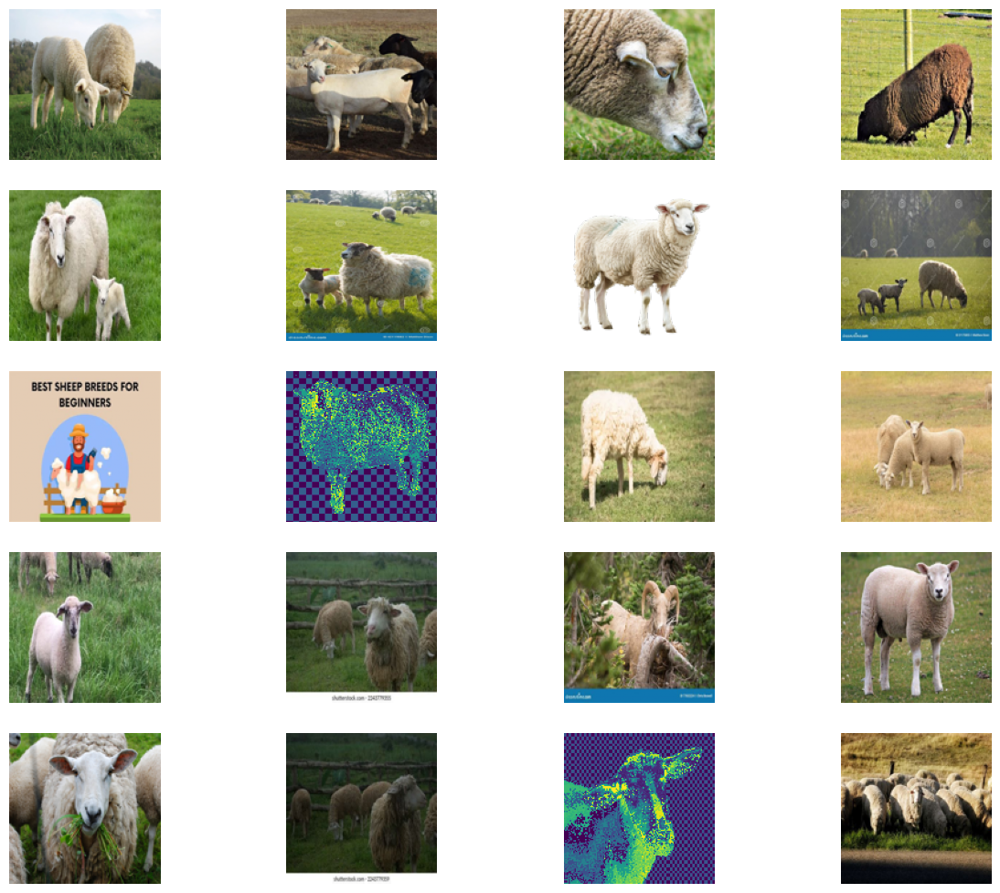

Contents of the dataset directory:
['healthsheep', 'unhealthysheep']


In [27]:
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
from torchvision.datasets import ImageFolder


# data = !unzip SHEEP.zip -d /content/SHEEPS.zip
data = '/content/SHEEPS.zip/SHEEP'
def show_images(dataset, num_samples=20, cols=4):
    """Plots some samples from the dataset."""
    plt.figure(figsize=(15, 15))

    # List all image files in the healthy and unhealthy subfolders
    image_files = []
    for folder in ['healthsheep', 'unhealthysheep']:
        folder_path = os.path.join(dataset, folder)
        if os.path.exists(folder_path):
            # Collect image files from both subfolders
            image_files.extend([os.path.join(folder_path, f) for f in os.listdir(folder_path)
                                if f.endswith(('png', 'jpg', 'jpeg', 'webp', 'tiff'))])

    # Check if any images were found
    if not image_files:
        print("No image files found in the specified directory.")
        return

    for i, img_path in enumerate(image_files):
        if i == num_samples:
            break
        img = Image.open(img_path)  # Load the image
        img = img.resize((128, 128))  # Optionally resize images to 128x128
        plt.subplot(int(num_samples / cols) + 1, cols, i + 1)
        plt.imshow(np.array(img) / 255.0)  # Normalize to [0, 1]
        plt.axis('off')  # Hide axes
    plt.show()

# Call the function to show images
show_images(data)

# Print the contents of the dataset directory for debugging
print("Contents of the dataset directory:")
print(os.listdir(data))

# Building the Diffusion Model


## Step 1: The forward process = Noise scheduler




We first need to build the inputs for our model, which are more and more noisy images. Instead of doing this sequentially, we can use the closed form to calculate the image for any of the timesteps individually.

**Key Takeaways**:
- The noise-levels/variances can be pre-computed
- There are different types of variance schedules
- We can sample each timestep image independently (Sums of Gaussians is also Gaussian)
- No model is needed in this forward step

In [28]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

Let's test it on our dataset ...

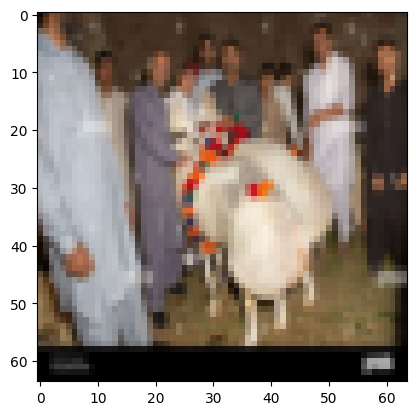

In [29]:
IMG_SIZE = 64
BATCH_SIZE = 128

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    train = ImageFolder(root=data, transform=data_transform)

    return train

def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

#Display a sample image
for images, labels in dataloader:
    show_tensor_image(images)
    break  # Just show one batch

<ipython-input-30-f4853fe96c6f>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


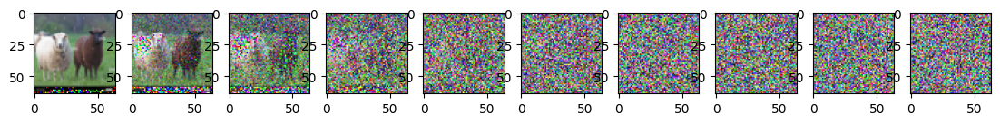

In [30]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

## Step 2: The backward process = U-Net





**Key Takeaways**:
- We use a simple form of a UNet for to predict the noise in the image
- The input is a noisy image, the ouput the noise in the image
- Because the parameters are shared accross time, we need to tell the network in which timestep we are
- The Timestep is encoded by the transformer Sinusoidal Embedding
- We output one single value (mean), because the variance is fixed


In [31]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor


**Further improvements that can be implemented:**
- Residual connections
- Different activation functions like SiLU, GWLU, ...
- BatchNormalization
- GroupNormalization
- Attention
- ...

## Step 3: The loss



**Key Takeaways:**
- After some maths we end up with a very simple loss function
- There are other possible choices like L2 loss ect.


In [32]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

## Sampling
- Without adding @torch.no_grad() we quickly run out of memory, because pytorch tacks all the previous images for gradient calculation
- Because we pre-calculated the noise variances for the forward pass, we also have to use them when we sequentially perform the backward process

In [33]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

## Training

Epoch 0 | step 000 Loss: 0.812099814414978 


<ipython-input-33-5fbd7b74e2b8>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


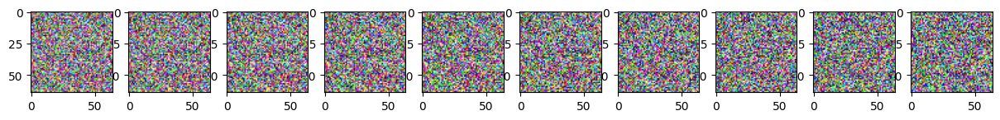

Epoch 5 | step 000 Loss: 0.613739550113678 


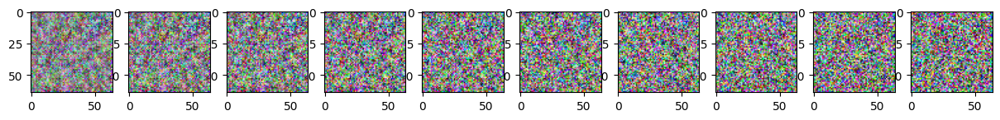

Epoch 10 | step 000 Loss: 0.4627353847026825 


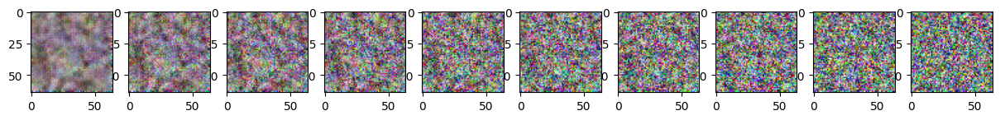

Epoch 15 | step 000 Loss: 0.4004836082458496 


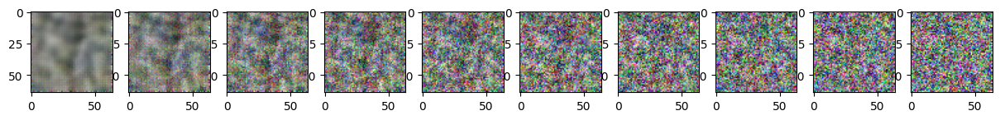

Epoch 20 | step 000 Loss: 0.3566999137401581 


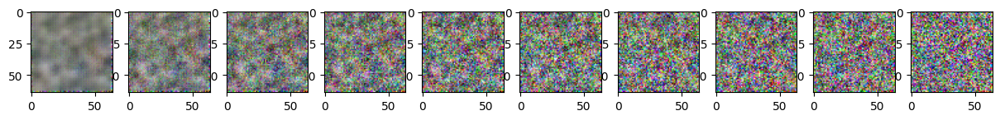

Epoch 25 | step 000 Loss: 0.3344001770019531 


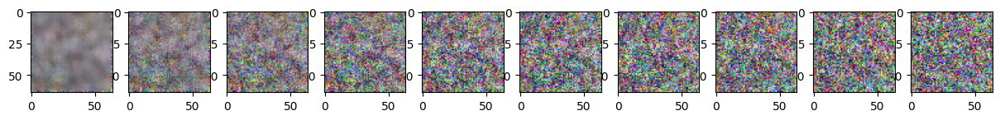

Epoch 30 | step 000 Loss: 0.30054372549057007 


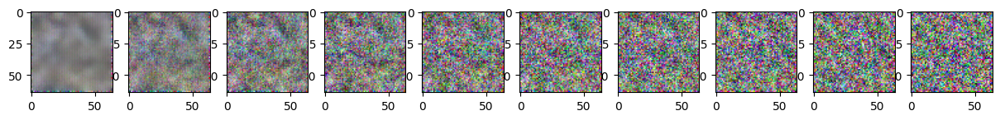

Epoch 35 | step 000 Loss: 0.2857379615306854 


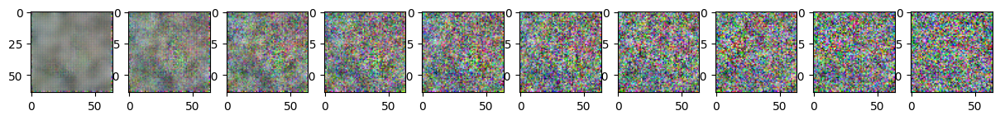

Epoch 40 | step 000 Loss: 0.41799747943878174 


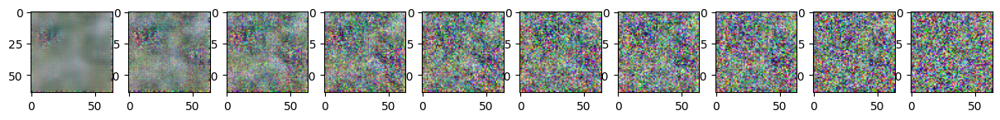

Epoch 45 | step 000 Loss: 0.3719870448112488 


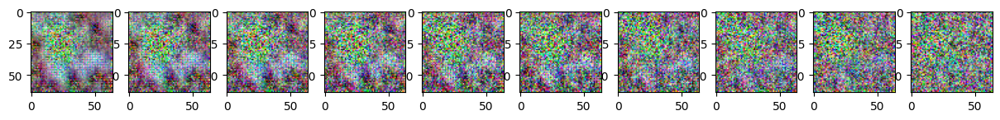

Epoch 50 | step 000 Loss: 0.32440924644470215 


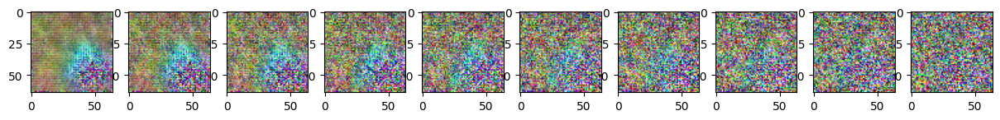

Epoch 55 | step 000 Loss: 0.35791561007499695 


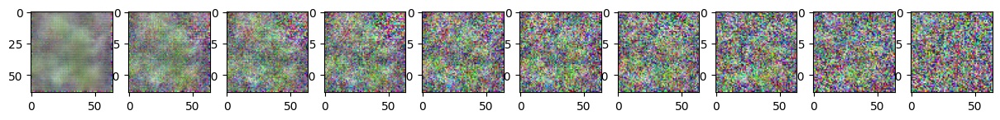

Epoch 60 | step 000 Loss: 0.3186056315898895 


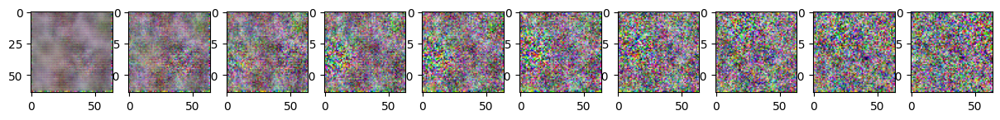

Epoch 65 | step 000 Loss: 0.29618388414382935 


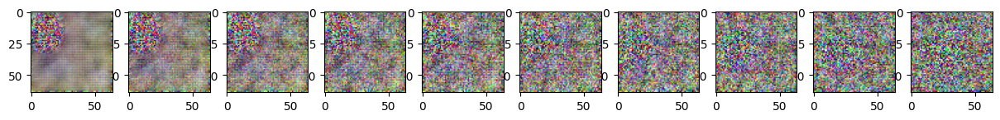

Epoch 70 | step 000 Loss: 0.2796769142150879 


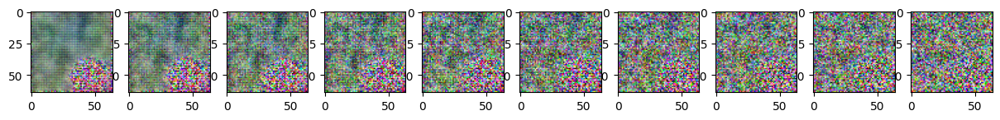

Epoch 75 | step 000 Loss: 0.2674389183521271 


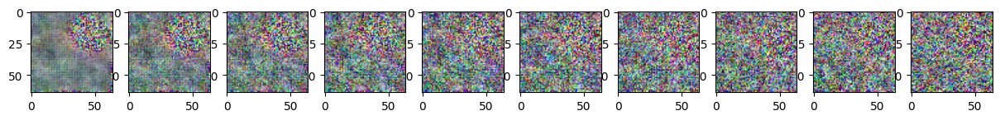

Epoch 80 | step 000 Loss: 0.2710810601711273 


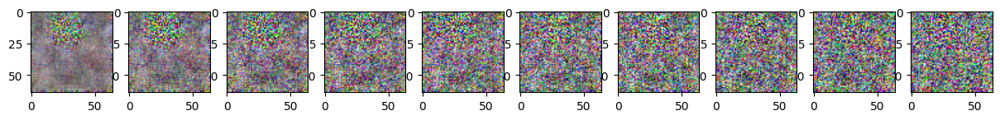

Epoch 85 | step 000 Loss: 0.25686201453208923 


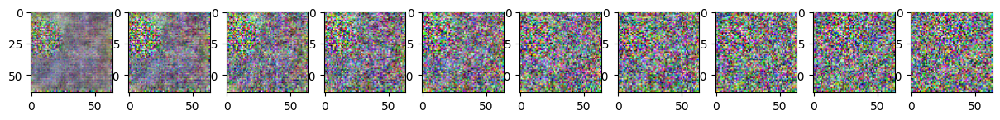

Epoch 90 | step 000 Loss: 0.2440304011106491 


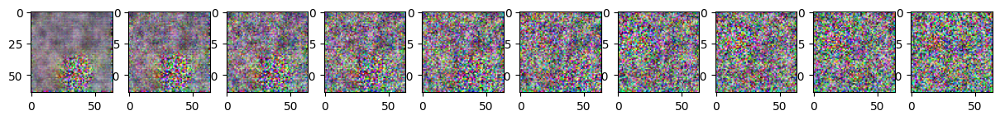

Epoch 95 | step 000 Loss: 0.26315996050834656 


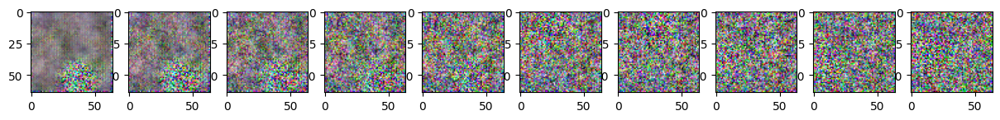

Epoch 100 | step 000 Loss: 0.27469465136528015 


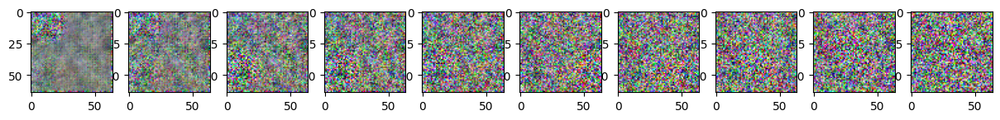

Epoch 105 | step 000 Loss: 0.2386920154094696 


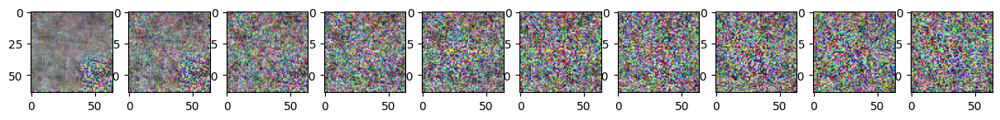

Epoch 110 | step 000 Loss: 0.24992477893829346 


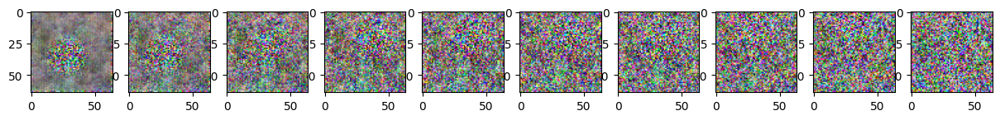

Epoch 115 | step 000 Loss: 0.25674039125442505 


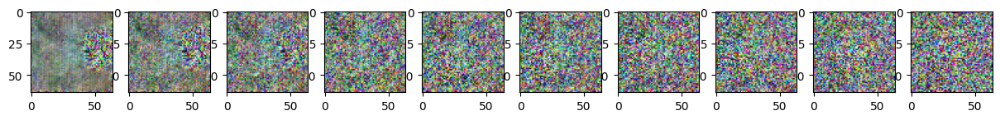

Epoch 120 | step 000 Loss: 0.29415690898895264 


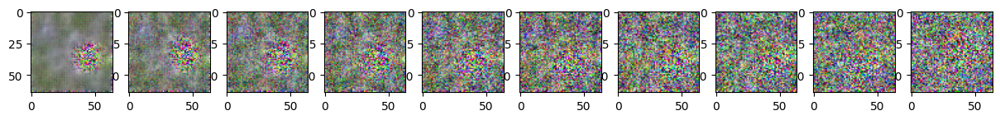

Epoch 125 | step 000 Loss: 0.2873672842979431 


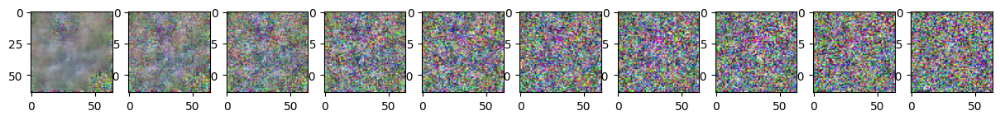

Epoch 130 | step 000 Loss: 0.2891952097415924 


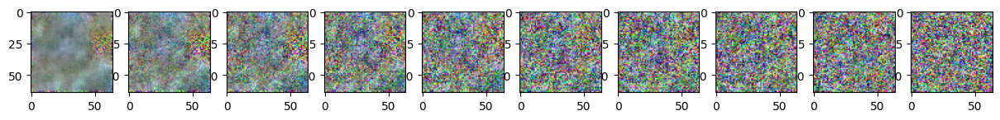

Epoch 135 | step 000 Loss: 0.27672481536865234 


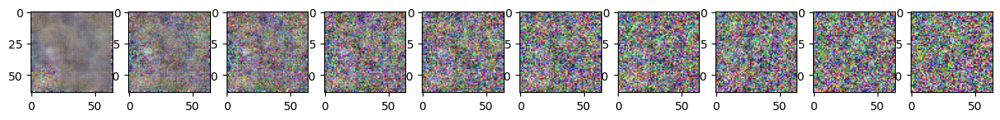

Epoch 140 | step 000 Loss: 0.2608984708786011 


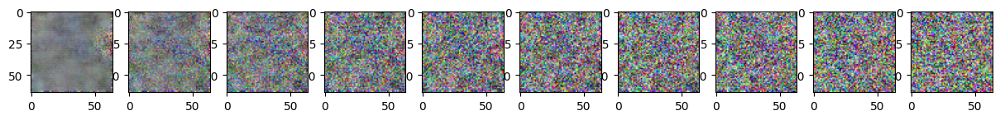

Epoch 145 | step 000 Loss: 0.2648032307624817 


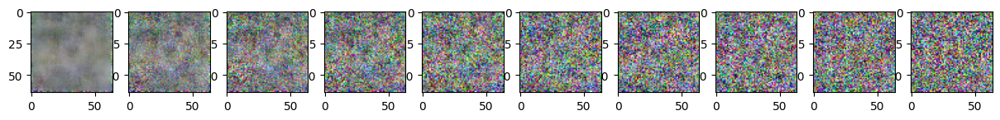

Epoch 150 | step 000 Loss: 0.2571273446083069 


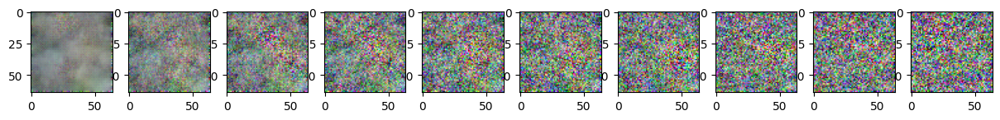

Epoch 155 | step 000 Loss: 0.24024510383605957 


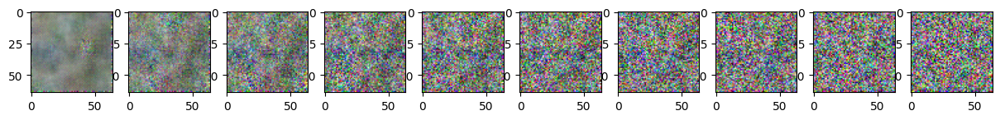

Epoch 160 | step 000 Loss: 0.2570433020591736 


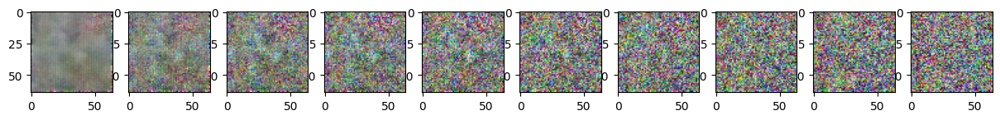

Epoch 165 | step 000 Loss: 0.2575318217277527 


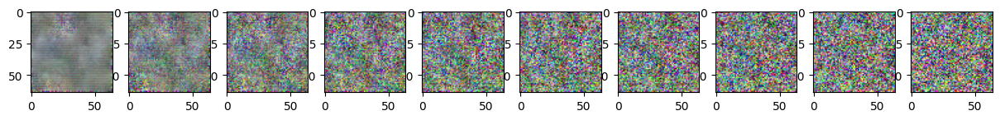

Epoch 170 | step 000 Loss: 0.25795644521713257 


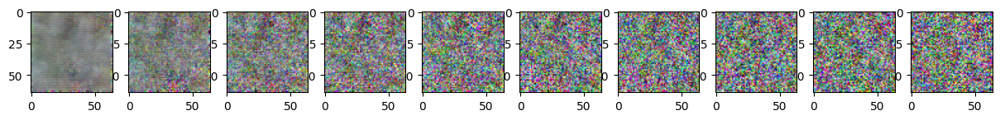

Epoch 175 | step 000 Loss: 0.24719807505607605 


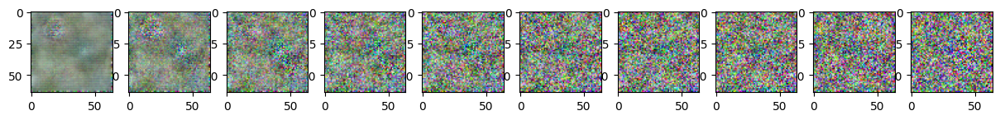

Epoch 180 | step 000 Loss: 0.22953110933303833 


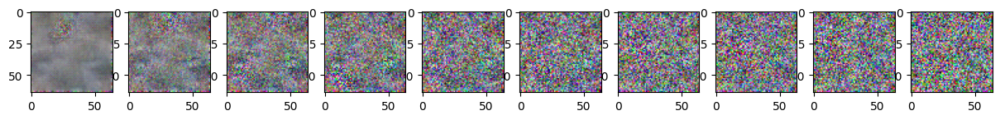

Epoch 185 | step 000 Loss: 0.24634712934494019 


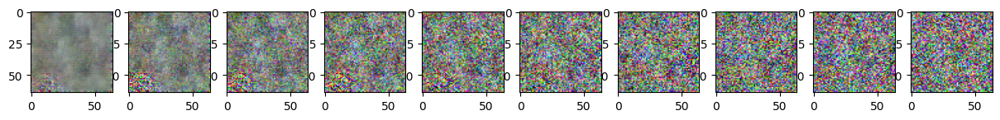

Epoch 190 | step 000 Loss: 0.22742587327957153 


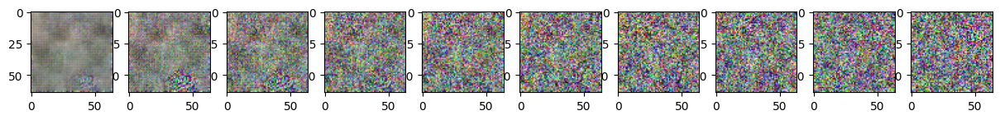

Epoch 195 | step 000 Loss: 0.2402857542037964 


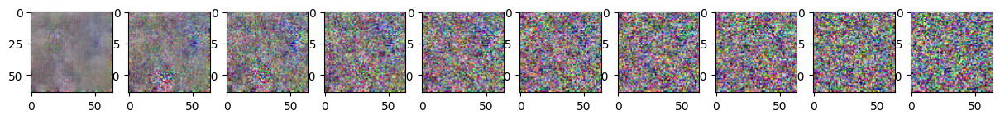

Epoch 200 | step 000 Loss: 0.2297496646642685 


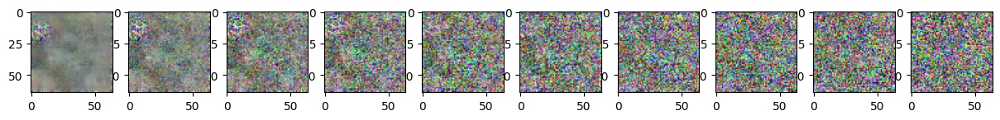

Epoch 205 | step 000 Loss: 0.21594098210334778 


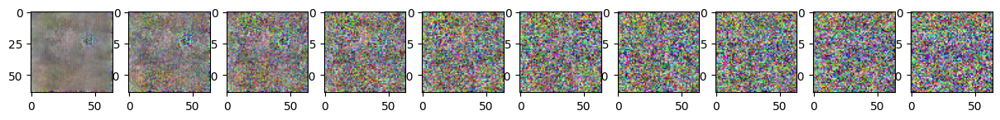

Epoch 210 | step 000 Loss: 0.24253366887569427 


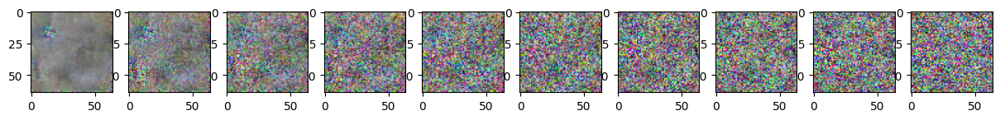

Epoch 215 | step 000 Loss: 0.20646131038665771 


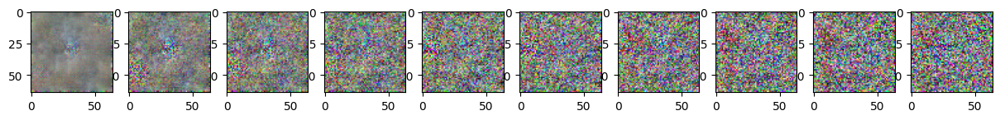

Epoch 220 | step 000 Loss: 0.23396438360214233 


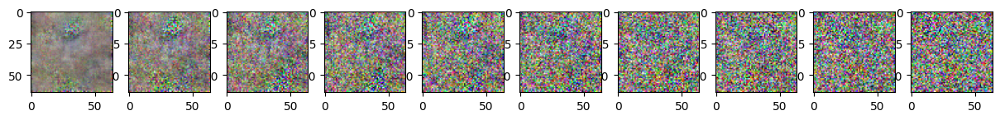

Epoch 225 | step 000 Loss: 0.211470827460289 


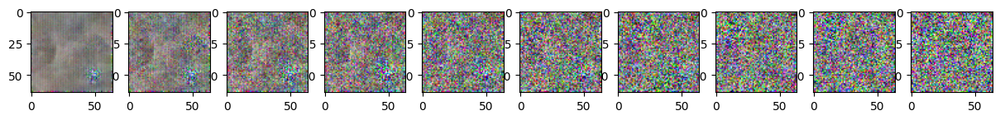

Epoch 230 | step 000 Loss: 0.22802352905273438 


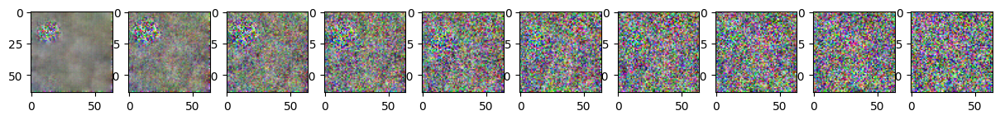

Epoch 235 | step 000 Loss: 0.23095570504665375 


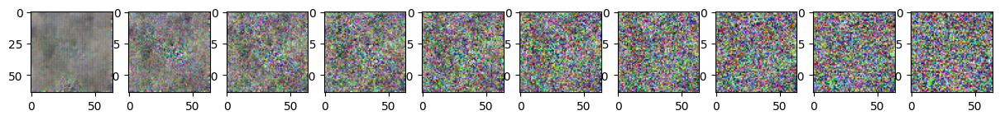

Epoch 240 | step 000 Loss: 0.22099369764328003 


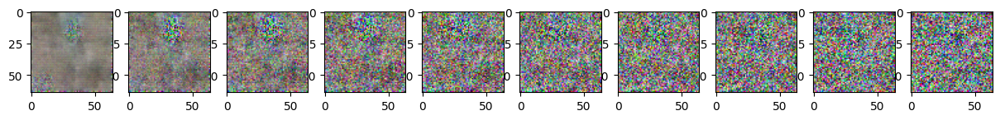

Epoch 245 | step 000 Loss: 0.2219662368297577 


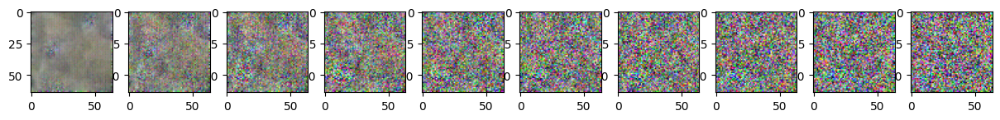

Epoch 250 | step 000 Loss: 0.20437996089458466 


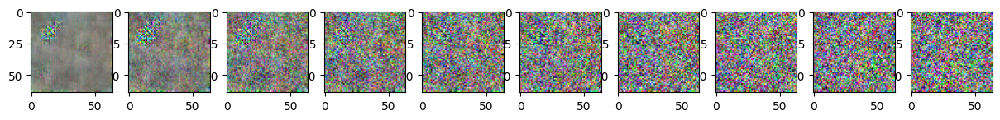

Epoch 255 | step 000 Loss: 0.23855280876159668 


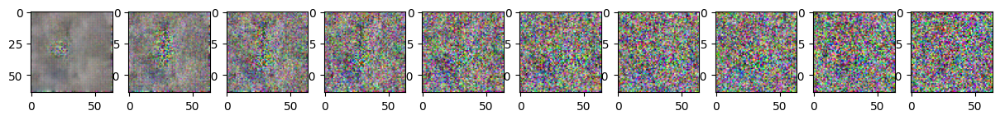

Epoch 260 | step 000 Loss: 0.21343515813350677 


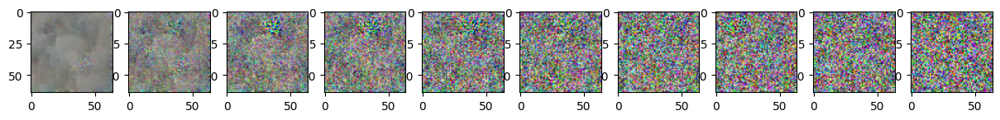

Epoch 265 | step 000 Loss: 0.21104180812835693 


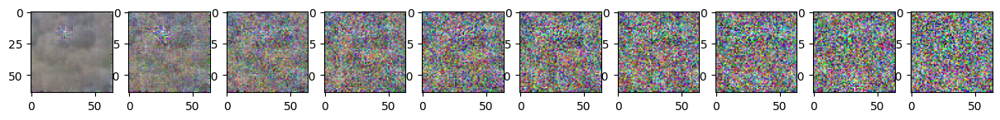

Epoch 270 | step 000 Loss: 0.21538779139518738 


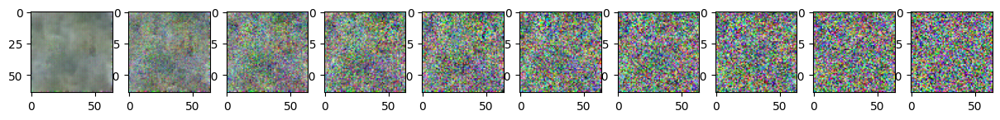

Epoch 275 | step 000 Loss: 0.20310541987419128 


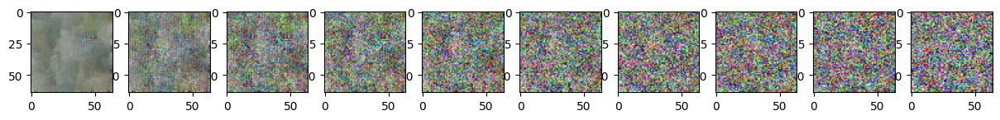

Epoch 280 | step 000 Loss: 0.21046464145183563 


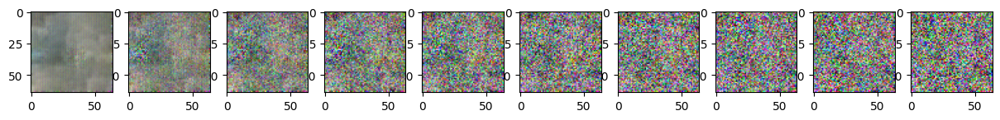

Epoch 285 | step 000 Loss: 0.19801780581474304 


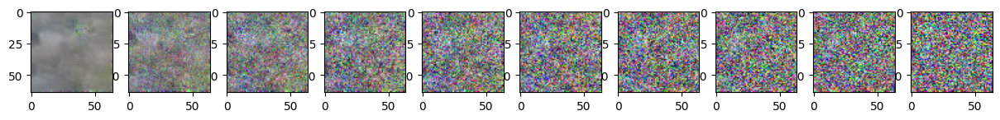

Epoch 290 | step 000 Loss: 0.22063963115215302 


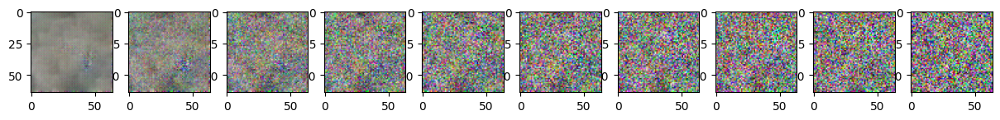

Epoch 295 | step 000 Loss: 0.19337663054466248 


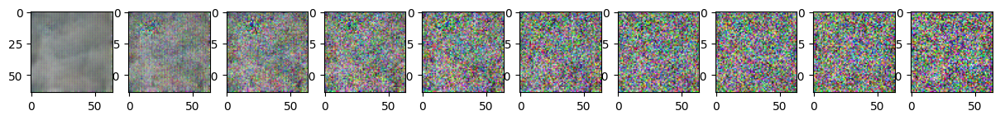

Epoch 300 | step 000 Loss: 0.2116786241531372 


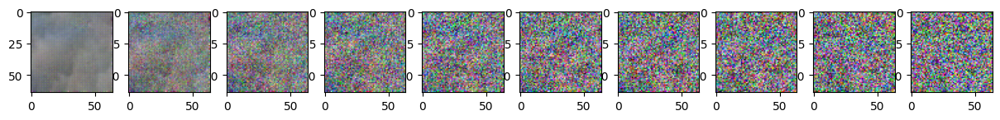

Epoch 305 | step 000 Loss: 0.20411252975463867 


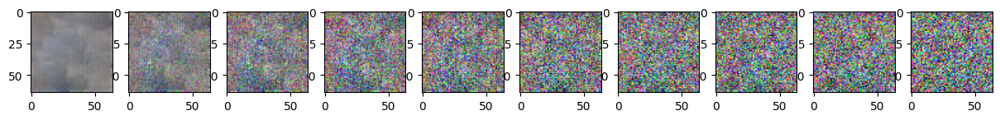

Epoch 310 | step 000 Loss: 0.2210097759962082 


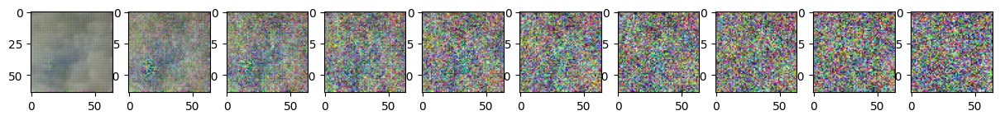

Epoch 315 | step 000 Loss: 0.19443731009960175 


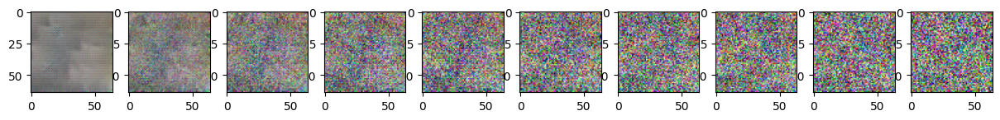

Epoch 320 | step 000 Loss: 0.209909126162529 


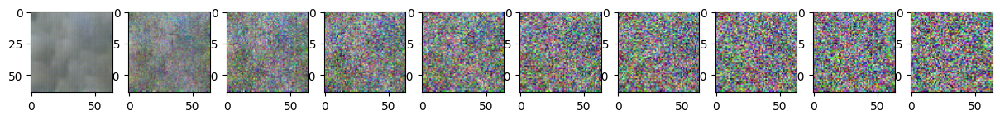

Epoch 325 | step 000 Loss: 0.21336399018764496 


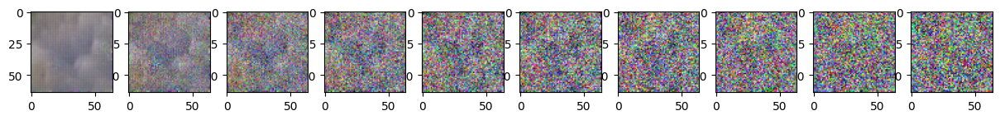

Epoch 330 | step 000 Loss: 0.18983855843544006 


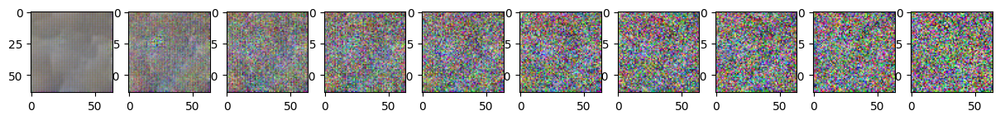

Epoch 335 | step 000 Loss: 0.20840021967887878 


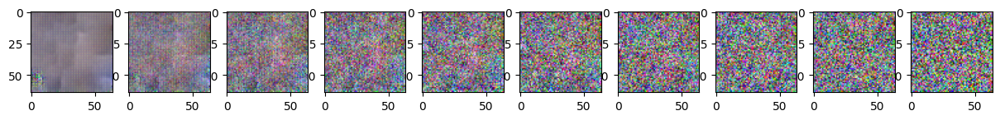

Epoch 340 | step 000 Loss: 0.19676081836223602 


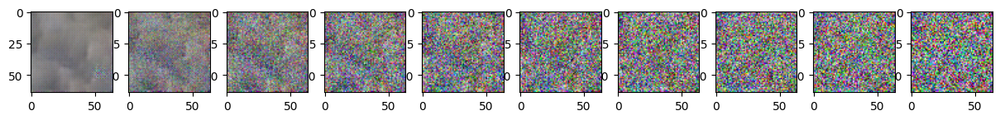

Epoch 345 | step 000 Loss: 0.20450013875961304 


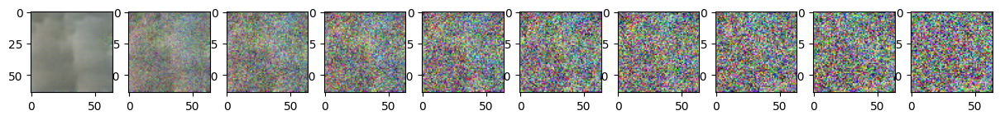

Epoch 350 | step 000 Loss: 0.20339807868003845 


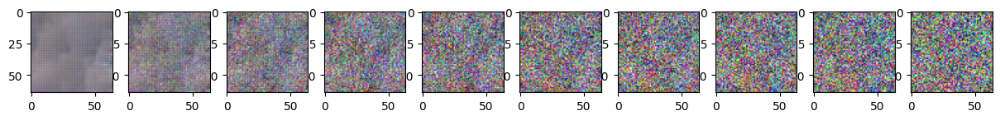

Epoch 355 | step 000 Loss: 0.21203264594078064 


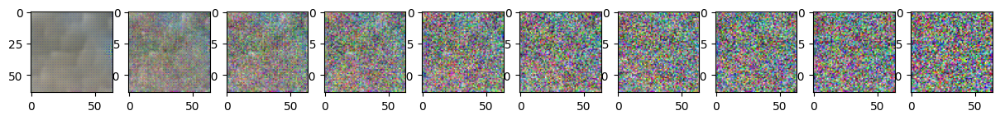

Epoch 360 | step 000 Loss: 0.173906609416008 


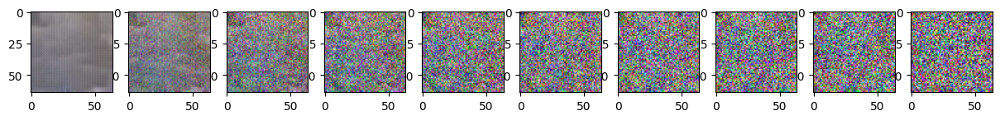

Epoch 365 | step 000 Loss: 0.1924038529396057 


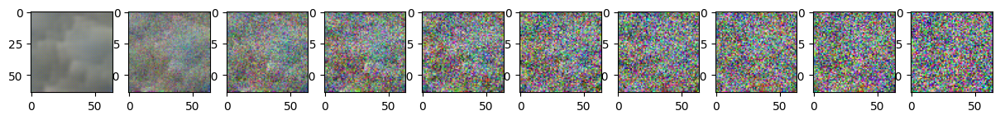

Epoch 370 | step 000 Loss: 0.18759939074516296 


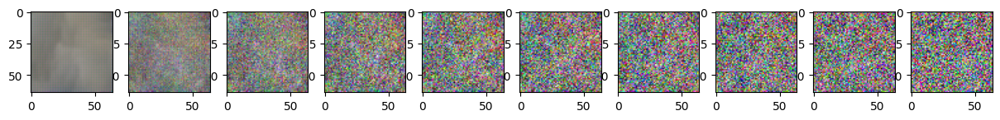

Epoch 375 | step 000 Loss: 0.1936541497707367 


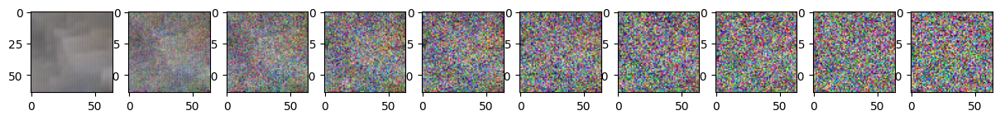

Epoch 380 | step 000 Loss: 0.21089133620262146 


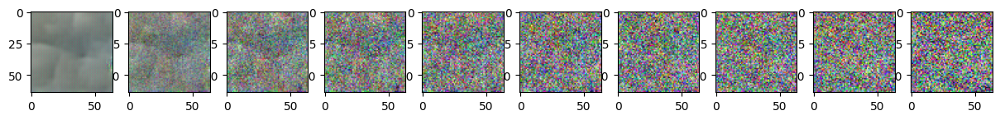

Epoch 385 | step 000 Loss: 0.18829886615276337 


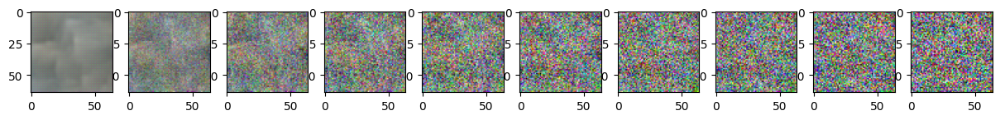

Epoch 390 | step 000 Loss: 0.1963718831539154 


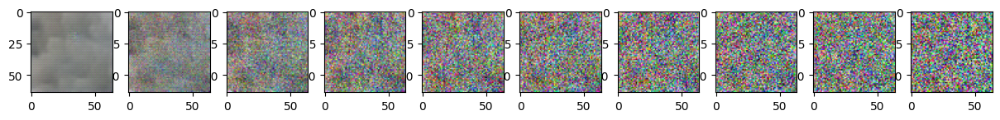

Epoch 395 | step 000 Loss: 0.18493017554283142 


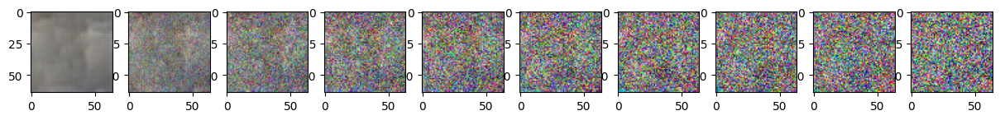

Epoch 400 | step 000 Loss: 0.17619751393795013 


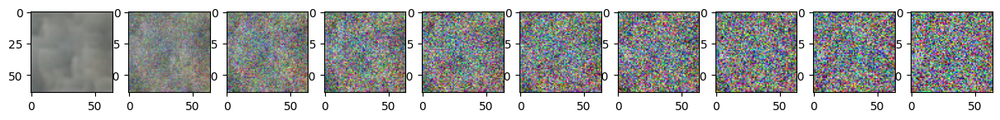

Epoch 405 | step 000 Loss: 0.19477084279060364 


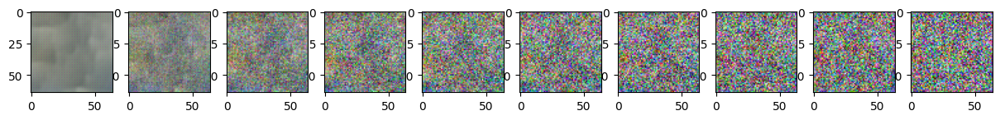

Epoch 410 | step 000 Loss: 0.18631672859191895 


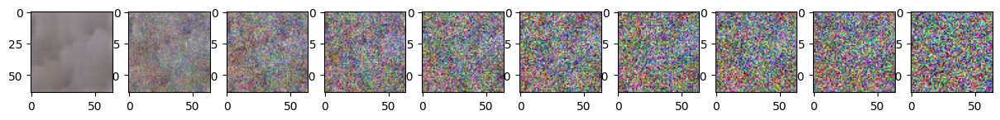

Epoch 415 | step 000 Loss: 0.18073073029518127 


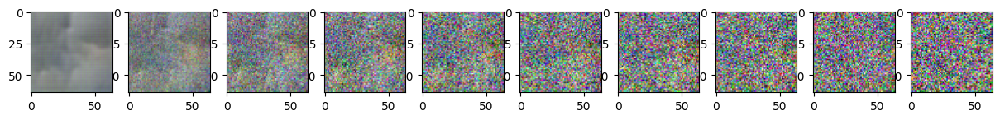

Epoch 420 | step 000 Loss: 0.1823640763759613 


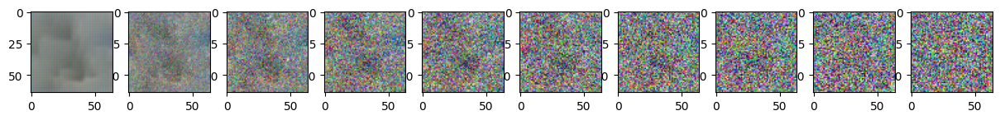

Epoch 425 | step 000 Loss: 0.17601345479488373 


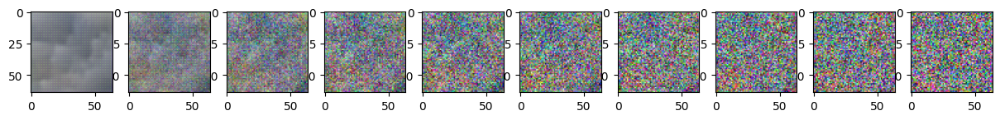

Epoch 430 | step 000 Loss: 0.18130120635032654 


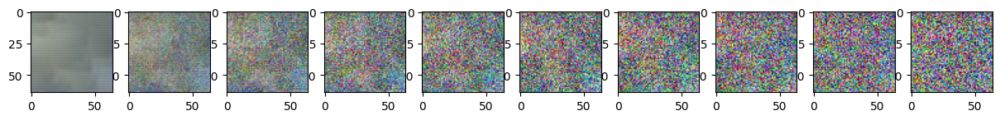

Epoch 435 | step 000 Loss: 0.18313199281692505 


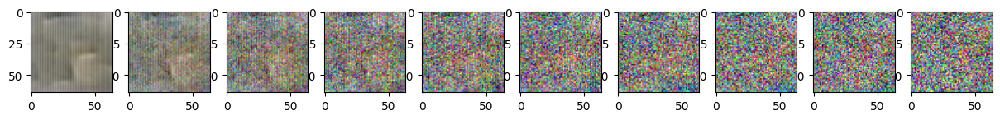

Epoch 440 | step 000 Loss: 0.18181884288787842 


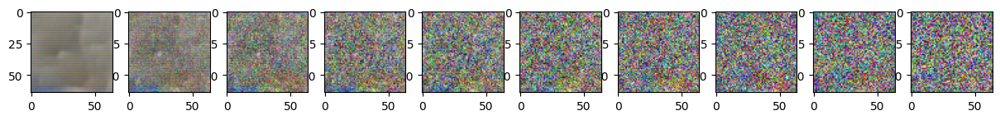

Epoch 445 | step 000 Loss: 0.17535632848739624 


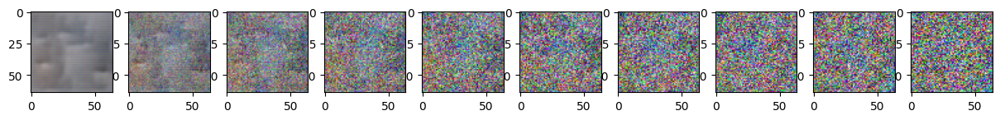

Epoch 450 | step 000 Loss: 0.17430290579795837 


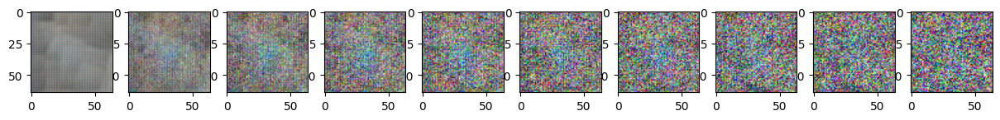

Epoch 455 | step 000 Loss: 0.17636525630950928 


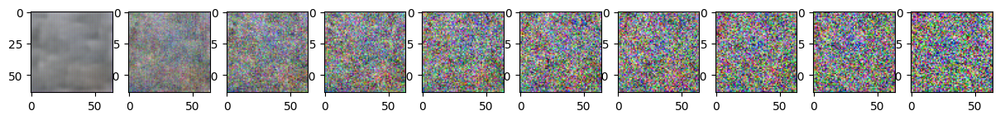

Epoch 460 | step 000 Loss: 0.18557292222976685 


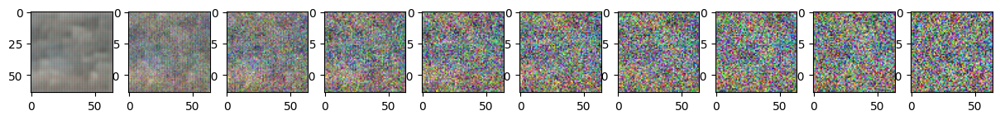

Epoch 465 | step 000 Loss: 0.17809078097343445 


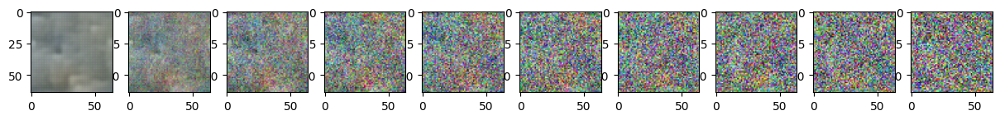

Epoch 470 | step 000 Loss: 0.16361920535564423 


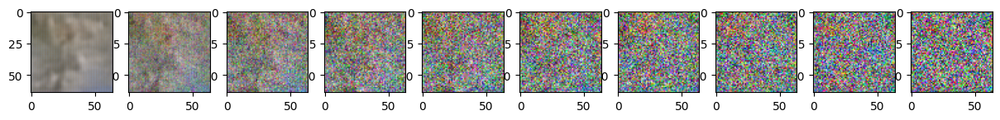

Epoch 475 | step 000 Loss: 0.17327523231506348 


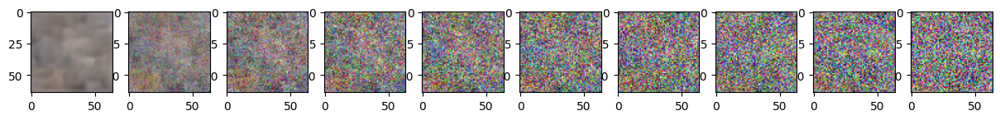

Epoch 480 | step 000 Loss: 0.1960201859474182 


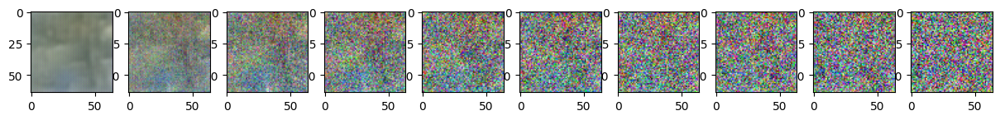

Epoch 485 | step 000 Loss: 0.18643665313720703 


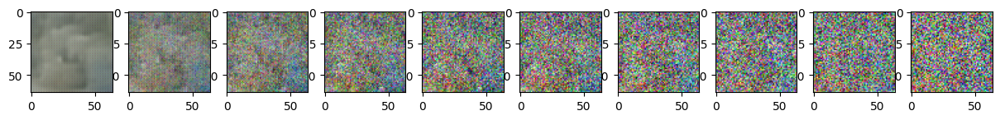

Epoch 490 | step 000 Loss: 0.16881239414215088 


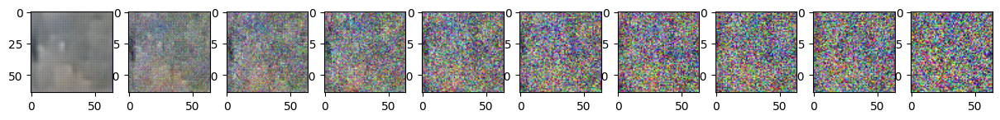

Epoch 495 | step 000 Loss: 0.17871055006980896 


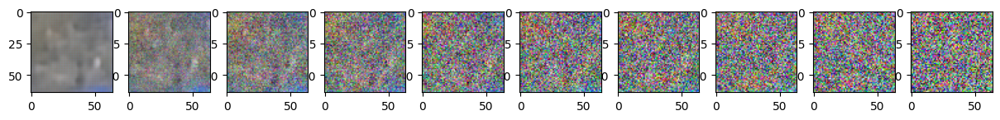

In [34]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 500 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()